1,prepare data

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas
import math
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import pandas as pd
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
import numpy

Using TensorFlow backend.


In [2]:
Open=pd.read_csv('SP500_new.csv', usecols=[1],engine='python', skipfooter=1).values.astype('float32')
High=pd.read_csv('SP500_new.csv', usecols=[2],engine='python', skipfooter=1).values.astype('float32')
Low=pd.read_csv('SP500_new.csv', usecols=[3],engine='python', skipfooter=1).values.astype('float32')
Close=pd.read_csv('SP500_new.csv', usecols=[4],engine='python', skipfooter=1).values.astype('float32')
Adjclose=pd.read_csv('SP500_new.csv', usecols=[5],engine='python', skipfooter=1).values.astype('float32')
Vloume=pd.read_csv('SP500_new.csv', usecols=[6],engine='python', skipfooter=1).values.astype('float32')

In [3]:
def preparedata(features):
    Open=pd.read_csv('SP500_new.csv', usecols=[1],engine='python', skipfooter=1).values.astype('float32')
    High=pd.read_csv('SP500_new.csv', usecols=[2],engine='python', skipfooter=1).values.astype('float32')
    Low=pd.read_csv('SP500_new.csv', usecols=[3],engine='python', skipfooter=1).values.astype('float32')
    Close=pd.read_csv('SP500_new.csv', usecols=[4],engine='python', skipfooter=1).values.astype('float32')
    Adjclose=pd.read_csv('SP500_new.csv', usecols=[5],engine='python', skipfooter=1).values.astype('float32')
    Vloume=pd.read_csv('SP500_new.csv', usecols=[6],engine='python', skipfooter=1).values.astype('float32')
    
    lenth=len(pd.read_csv('SP500_new.csv', usecols=[1],engine='python', skipfooter=1).values.astype('float32'))
    
    dataX = []
    for i in range(lenth):
        a=[]
        for feature in features:
            a.append(feature[i, 0])
        dataX.append(a)
    dataset=numpy.array(dataX)

    dataY = []
    for i in range(1,lenth):
        a=[]
        a.append(Adjclose[i, 0])
        dataY.append(a)
    target=numpy.array(dataY)

    dataset=dataset[:-1]

    # normalize the dataset
    scaler_dataset = MinMaxScaler(feature_range=(0, 1))
    dataset = scaler_dataset.fit_transform(dataset)

    # normalize the dataset
    scaler_target = MinMaxScaler(feature_range=(0, 1))
    target = scaler_target.fit_transform(target)

    trainX=dataset[:-500]
    testX=dataset[-500:]
    trainY=target[:-500]
    testY=target[-500:]

    # reshape input to be [samples, time steps, features]
    trainX = numpy.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
    testX = numpy.reshape(testX, (testX.shape[0], 1, testX.shape[1]))
    return trainX,trainY,testX,testY,scaler_dataset,scaler_target


2,build benchmark model-Persistence Model

In [6]:
from sklearn.metrics import mean_squared_error
from math import sqrt
from matplotlib import pyplot
pred=testY[:-1]
true=testY[1:]
# report performance
rmse = sqrt(mean_squared_error(true,pred))
print('RMSE: %.3f' % rmse)

RMSE: 0.010


In [7]:
from sklearn.metrics import r2_score
print(r2_score(true,pred))

0.986551559804


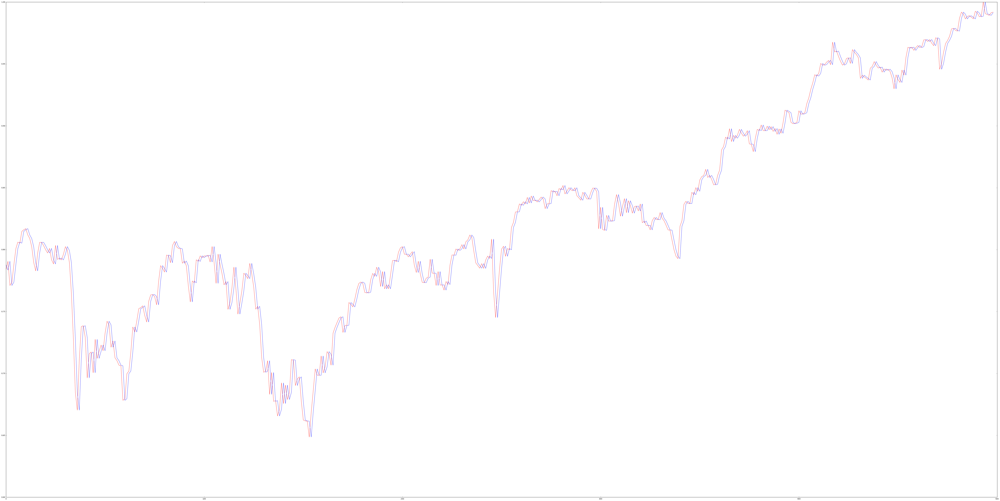

In [8]:
fig, ax = plt.subplots(figsize=(100, 50))
plt.plot(true,color='red')
plt.plot(pred,color='blue')
plt.show()

In [9]:
test_true=true[:]
test_pred=pred[:]

In [10]:
test_true_clssfi=[]
for  i in range(1,len(test_true)):
    if test_true[i]>test_true[i-1]:
        test_true_clssfi.append(1)
    else:
        test_true_clssfi.append(0)

In [11]:
test_pred_clssfi=[]
for  i in range(1,len(test_pred)):
    if test_pred[i]>test_true[i-1]:
        test_pred_clssfi.append(1)
    else:
        test_pred_clssfi.append(0)

In [12]:
from sklearn.metrics import accuracy_score
accuracy=[]
for i in range(1,len(test_pred_clssfi)+1):
    accuracy.append(accuracy_score(test_true_clssfi[0:i],test_pred_clssfi[0:i]))

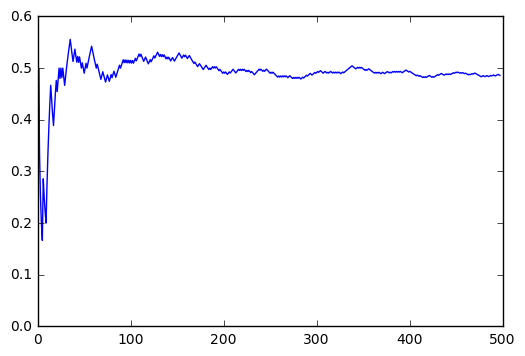

In [13]:
plt.plot(accuracy)
plt.show()

In [14]:
import numpy as np
print('Mean of accuracy score:')
print(np.mean(accuracy))

Mean of accuracy score:
0.490112482061


In [15]:
print('29days accuracy score:')
print(np.mean(accuracy[29]))

29days accuracy score:
0.466666666667


3,establish best model from playground,both stateless and stateful

3.1 stateless,shuffle=True,epochs=500,layer=1,neuron=4,dropout=0,all features

In [4]:
repeats=5

Epoch 1/500
6s - loss: 0.0025
Epoch 2/500
5s - loss: 1.0233e-04
Epoch 3/500
6s - loss: 1.0086e-04
Epoch 4/500
5s - loss: 9.8019e-05
Epoch 5/500
5s - loss: 9.9866e-05
Epoch 6/500
5s - loss: 9.6945e-05
Epoch 7/500
5s - loss: 9.4499e-05
Epoch 8/500
5s - loss: 9.1200e-05
Epoch 9/500
5s - loss: 9.1347e-05
Epoch 10/500
5s - loss: 9.1049e-05
Epoch 11/500
5s - loss: 8.8165e-05
Epoch 12/500
5s - loss: 8.8900e-05
Epoch 13/500
5s - loss: 8.8656e-05
Epoch 14/500
5s - loss: 8.7842e-05
Epoch 15/500
5s - loss: 8.7763e-05
Epoch 16/500
5s - loss: 8.8882e-05
Epoch 17/500
5s - loss: 8.5752e-05
Epoch 18/500
5s - loss: 8.6636e-05
Epoch 19/500
5s - loss: 8.8928e-05
Epoch 20/500
5s - loss: 8.6342e-05
Epoch 21/500
5s - loss: 8.5600e-05
Epoch 22/500
5s - loss: 8.6947e-05
Epoch 23/500
5s - loss: 8.3088e-05
Epoch 24/500
5s - loss: 8.7010e-05
Epoch 25/500
5s - loss: 8.5914e-05
Epoch 26/500
5s - loss: 8.5719e-05
Epoch 27/500
5s - loss: 8.4889e-05
Epoch 28/500
5s - loss: 8.5714e-05
Epoch 29/500
5s - loss: 8.6745e-0

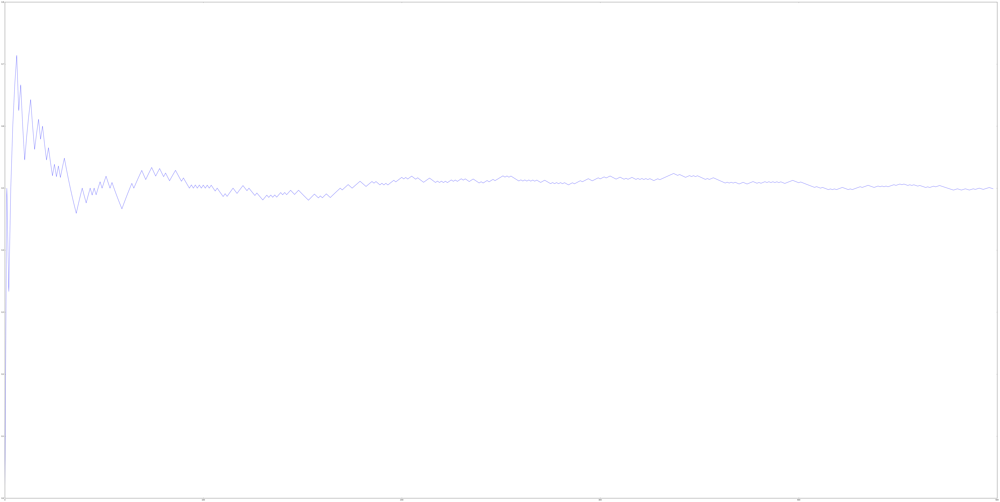

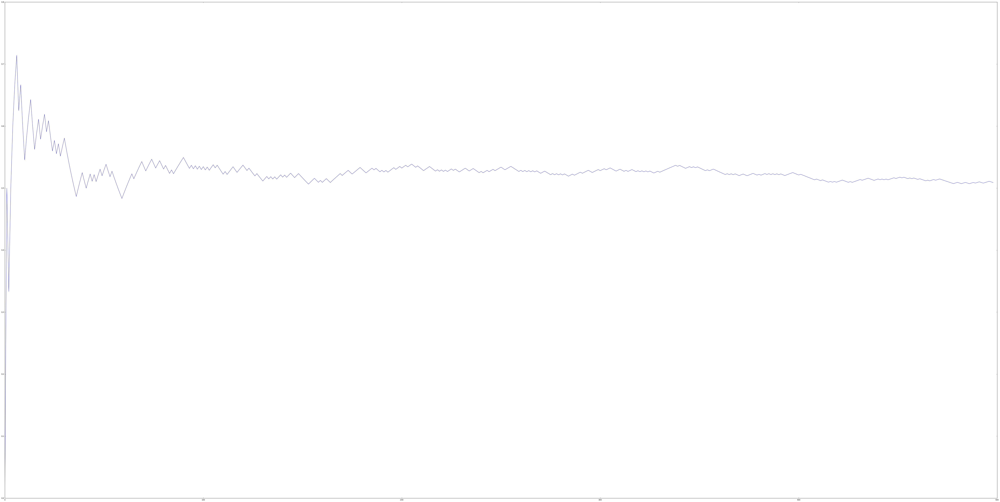

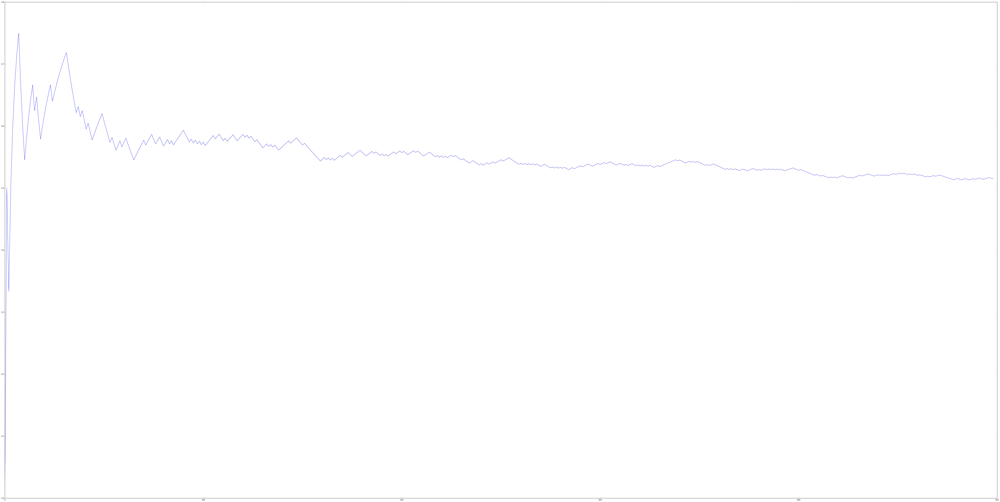

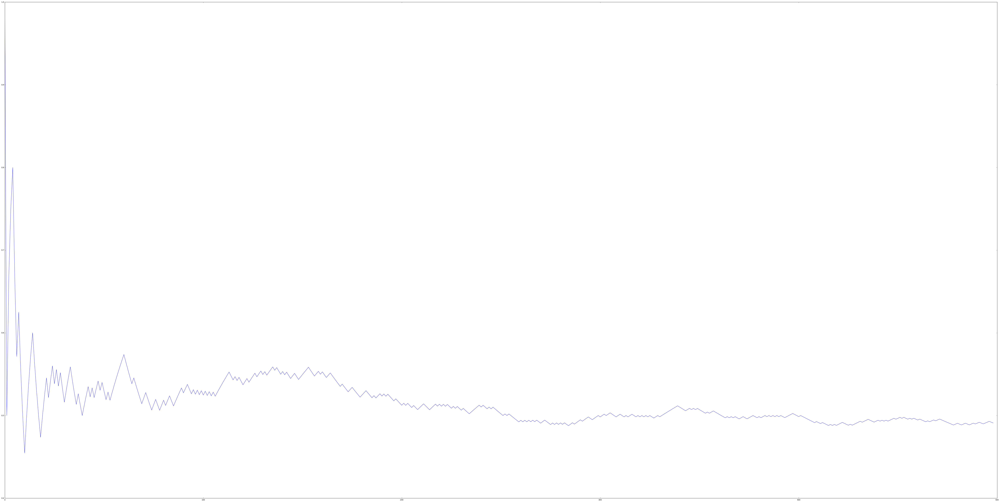

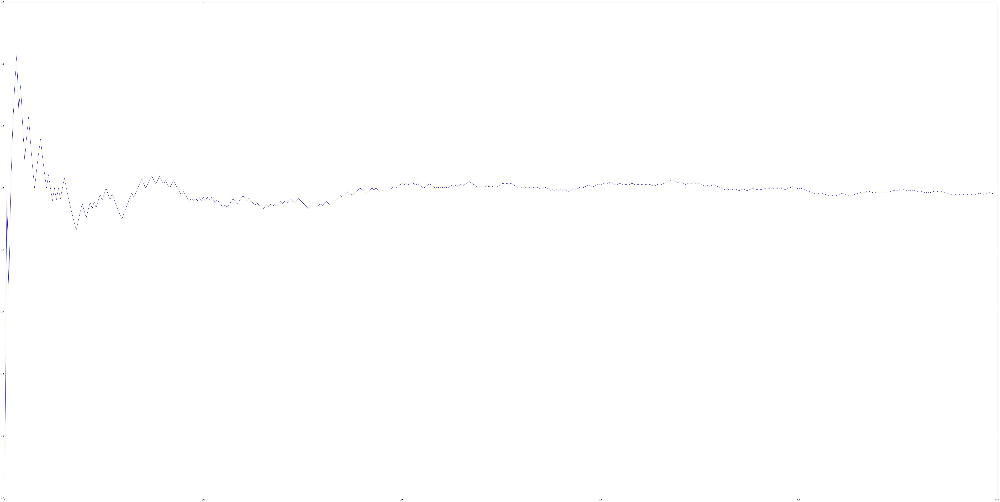

adjclose plot


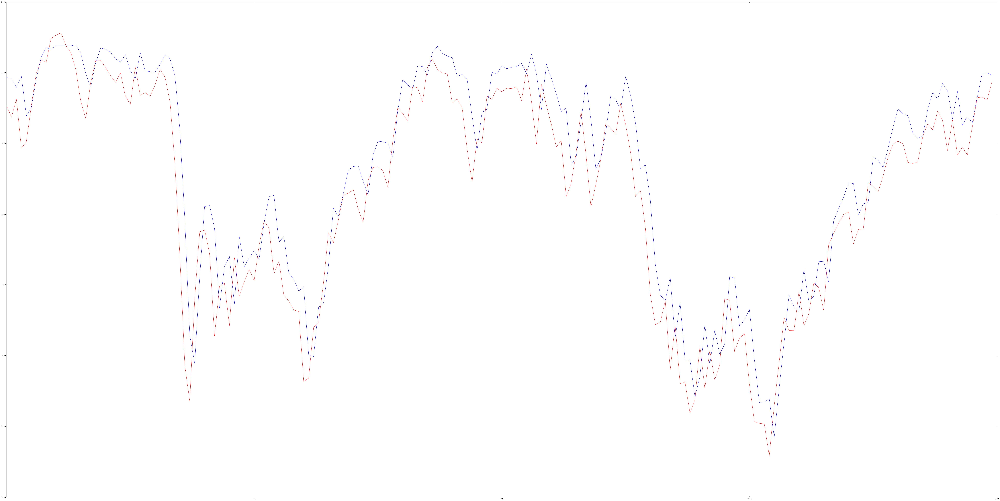

mean of train_RMSE
15.1885512369
std of train_RMSE
0.345217847426
mean of test_RMSE
128.024777987
std of test_RMSE
1.28261001808
mean of test_r2Score
0.259357787757
std of test_r2Score
0.0147947606014
mean of accuracy_all
0.519531386652
std of accuracy_all
0.0187434479616
mean of accuracy_30
0.566666666667
std of accuracy_30
0.069920589878
time cost
13132.079111814499


In [5]:
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score



import time
start = time.time()
train_RMSE=[]
test_RMSE=[]
test_r2Score=[]
accuracy_all=[]
accuracy_30=[]

for i in range(repeats):
    trainX,trainY,testX,testY,scaler_dataset,scaler_target=preparedata([Open,High,Low,Close,Adjclose,Vloume])
    # create and fit the LSTM network
    model = Sequential()
    model.add(LSTM(4, input_shape=(1,6)))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(trainX, trainY, epochs=500, batch_size=1, verbose=2,shuffle=True)


    # make predictions
    trainPredict = model.predict(trainX)
    testPredict = model.predict(testX)
    # invert predictions
    trainPredict =  scaler_target.inverse_transform(trainPredict)
    trainY =  scaler_target.inverse_transform(trainY)
    testPredict =  scaler_target.inverse_transform(testPredict)
    testY =  scaler_target.inverse_transform(testY)
    # calculate root mean squared error
    train_RMSE.append(math.sqrt(mean_squared_error(trainY, trainPredict)))
    
    test_RMSE.append(math.sqrt(mean_squared_error(testY, testPredict)))
    
   
    test_r2Score.append(r2_score(testY, testPredict))

    

    #transfer to classification probelm
    test_true=testY[:]
    test_pred=testPredict[:]

    test_true_clssfi=[]
    for  i in range(1,len(test_true)):
        if test_true[i]>test_true[i-1]:
            test_true_clssfi.append(1)
        else:
            test_true_clssfi.append(0)

    test_pred_clssfi=[]
    for  i in range(1,len(test_pred)):
        if test_pred[i]>test_true[i-1]:
            test_pred_clssfi.append(1)
        else:
            test_pred_clssfi.append(0)

    accuracy=[]
    for i in range(1,len(test_pred_clssfi)+1):
        accuracy.append(accuracy_score(test_true_clssfi[0:i],test_pred_clssfi[0:i]))
    fig, ax = plt.subplots(figsize=(100, 50))
    plt.plot(accuracy)
    accuracy_all.append(np.mean(accuracy))
    print(accuracy[29])
    accuracy_30.append(accuracy[29])

print('accuracy plot')    
plt.show()

print('adjclose plot')  
test_true=testY[:200]
test_pred=testPredict[:200]

fig, ax = plt.subplots(figsize=(100, 50))
plt.plot(test_true,color='red')
plt.plot(test_pred,color='blue')
plt.show()

print('mean of train_RMSE')
print(np.mean(train_RMSE))

print('std of train_RMSE')
print(np.std(train_RMSE))

print('mean of test_RMSE')
print(np.mean(test_RMSE))

print('std of test_RMSE')
print(np.std(test_RMSE))

print('mean of test_r2Score')
print(np.mean(test_r2Score))

print('std of test_r2Score')
print(np.std(test_r2Score))

print('mean of accuracy_all')
print(np.mean(accuracy_all))

print('std of accuracy_all')
print(np.std(accuracy_all))

print('mean of accuracy_30')
print(np.mean(accuracy_30))

print('std of accuracy_30')
print(np.std(accuracy_30))

print('time cost')
print( time.time() - start)  

3.2 stateless,shuffle=False,epochs=500,layer=1,neuron=4,dropout=0,all features

Epoch 1/500
5s - loss: 2.9926e-04
Epoch 2/500
5s - loss: 1.5259e-04
Epoch 3/500
5s - loss: 1.3856e-04
Epoch 4/500
5s - loss: 1.3208e-04
Epoch 5/500
5s - loss: 1.2737e-04
Epoch 6/500
5s - loss: 1.2388e-04
Epoch 7/500
5s - loss: 1.2044e-04
Epoch 8/500
5s - loss: 1.1803e-04
Epoch 9/500
5s - loss: 1.1581e-04
Epoch 10/500
5s - loss: 1.1395e-04
Epoch 11/500
5s - loss: 1.1233e-04
Epoch 12/500
5s - loss: 1.1094e-04
Epoch 13/500
5s - loss: 1.0973e-04
Epoch 14/500
5s - loss: 1.0867e-04
Epoch 15/500
5s - loss: 1.0774e-04
Epoch 16/500
5s - loss: 1.0690e-04
Epoch 17/500
5s - loss: 1.0614e-04
Epoch 18/500
5s - loss: 1.0542e-04
Epoch 19/500
5s - loss: 1.0472e-04
Epoch 20/500
5s - loss: 1.0403e-04
Epoch 21/500
5s - loss: 1.0331e-04
Epoch 22/500
5s - loss: 1.0258e-04
Epoch 23/500
5s - loss: 1.0182e-04
Epoch 24/500
5s - loss: 1.0106e-04
Epoch 25/500
5s - loss: 1.0038e-04
Epoch 26/500
5s - loss: 9.9767e-05
Epoch 27/500
5s - loss: 9.9232e-05
Epoch 28/500
5s - loss: 9.8772e-05
Epoch 29/500
5s - loss: 9.839

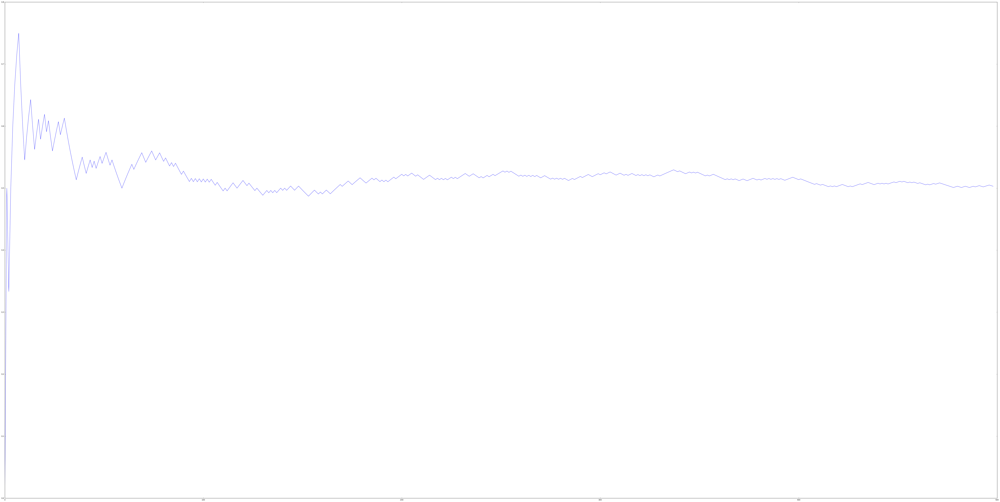

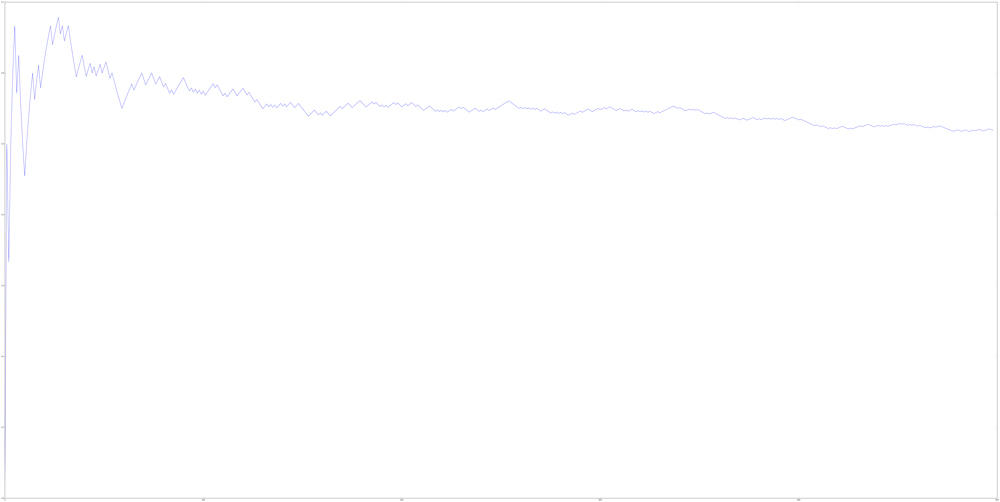

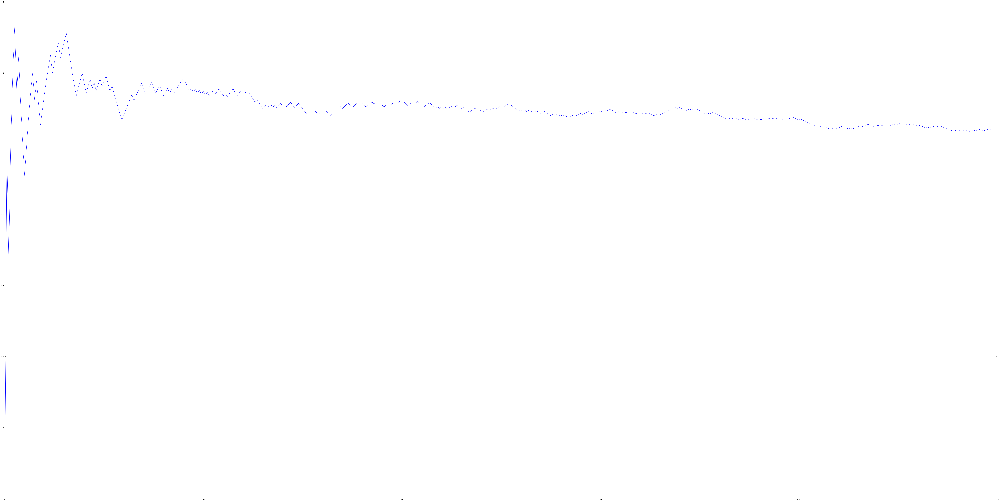

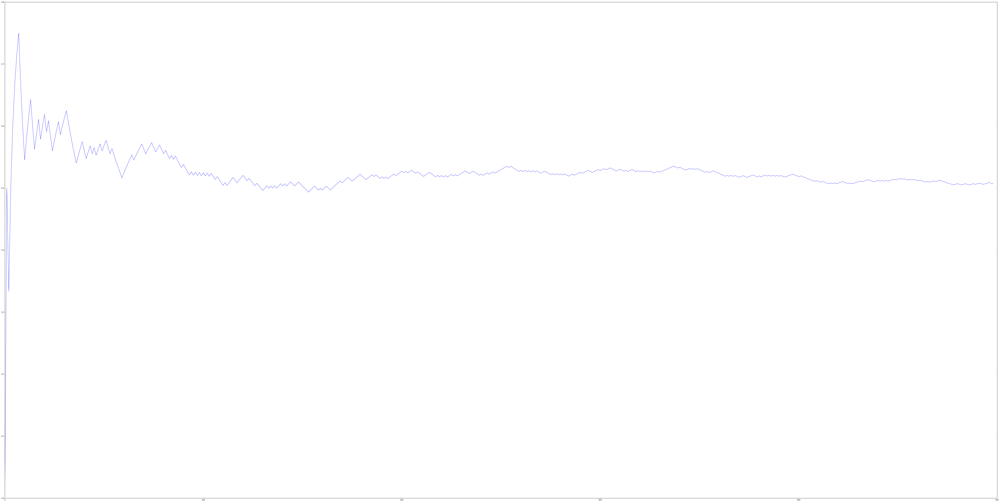

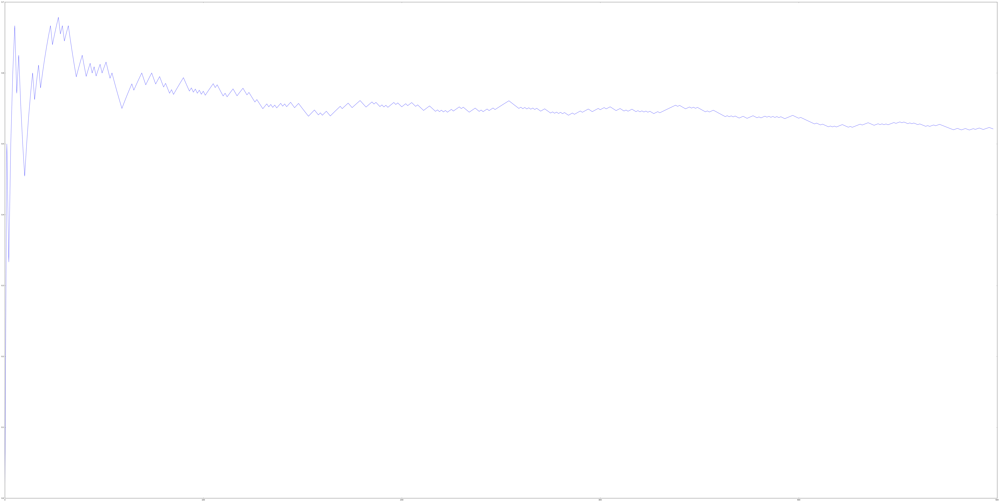

adjclose plot


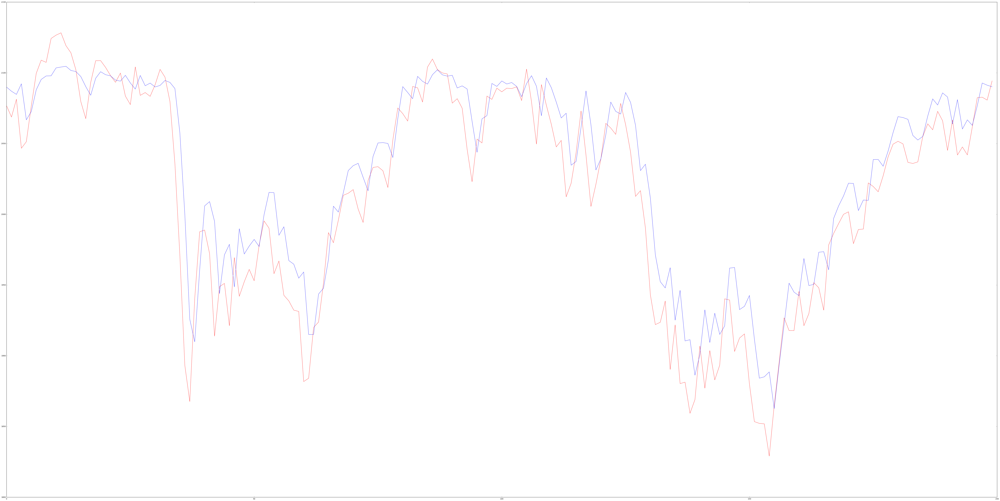

mean of train_RMSE
125.081313731
std of train_RMSE
16.222558387
mean of test_RMSE
115.011281367
std of test_RMSE
18.6018648822
mean of test_r2Score
0.38670049462
std of test_r2Score
0.198275090031
mean of accuracy_all
0.539521915573
std of accuracy_all
0.0139972592424
mean of accuracy_30
0.633333333333
std of accuracy_30
0.0298142397
time cost
13598.319779396057


In [6]:
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score


import time
start = time.time()
train_RMSE=[]
test_RMSE=[]
test_r2Score=[]
accuracy_all=[]
accuracy_30=[]

for i in range(repeats):
    trainX,trainY,testX,testY,scaler_dataset,scaler_target=preparedata([Open,High,Low,Close,Adjclose,Vloume])
    # create and fit the LSTM network
    model = Sequential()
    model.add(LSTM(4, input_shape=(1,6)))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(trainX, trainY, epochs=500, batch_size=1, verbose=2,shuffle=False)


    # make predictions
    trainPredict = model.predict(trainX)
    testPredict = model.predict(testX)
    # invert predictions
    trainPredict =  scaler_target.inverse_transform(trainPredict)
    trainY =  scaler_target.inverse_transform(trainY)
    testPredict =  scaler_target.inverse_transform(testPredict)
    testY =  scaler_target.inverse_transform(testY)
    # calculate root mean squared error
    train_RMSE.append(math.sqrt(mean_squared_error(trainY, trainPredict)))
    
    test_RMSE.append(math.sqrt(mean_squared_error(testY, testPredict)))
    
   
    test_r2Score.append(r2_score(testY, testPredict))

    

    #transfer to classification probelm
    test_true=testY[:]
    test_pred=testPredict[:]

    test_true_clssfi=[]
    for  i in range(1,len(test_true)):
        if test_true[i]>test_true[i-1]:
            test_true_clssfi.append(1)
        else:
            test_true_clssfi.append(0)

    test_pred_clssfi=[]
    for  i in range(1,len(test_pred)):
        if test_pred[i]>test_true[i-1]:
            test_pred_clssfi.append(1)
        else:
            test_pred_clssfi.append(0)

    accuracy=[]
    for i in range(1,len(test_pred_clssfi)+1):
        accuracy.append(accuracy_score(test_true_clssfi[0:i],test_pred_clssfi[0:i]))
    fig, ax = plt.subplots(figsize=(100, 50))
    plt.plot(accuracy)
    accuracy_all.append(np.mean(accuracy))
    print(accuracy[29])
    accuracy_30.append(accuracy[29])

print('accuracy plot')    
plt.show()

print('adjclose plot')  
test_true=testY[:200]
test_pred=testPredict[:200]

fig, ax = plt.subplots(figsize=(100, 50))
plt.plot(test_true,color='red')
plt.plot(test_pred,color='blue')
plt.show()

print('mean of train_RMSE')
print(np.mean(train_RMSE))

print('std of train_RMSE')
print(np.std(train_RMSE))

print('mean of test_RMSE')
print(np.mean(test_RMSE))

print('std of test_RMSE')
print(np.std(test_RMSE))

print('mean of test_r2Score')
print(np.mean(test_r2Score))

print('std of test_r2Score')
print(np.std(test_r2Score))

print('mean of accuracy_all')
print(np.mean(accuracy_all))

print('std of accuracy_all')
print(np.std(accuracy_all))

print('mean of accuracy_30')
print(np.mean(accuracy_30))

print('std of accuracy_30')
print(np.std(accuracy_30))

print('time cost')
print( time.time() - start)  

3.3 statelful,epochs=500,layer=1,neuron=4,dropout=0,all features

Epoch 1/1
6s - loss: 2.8261e-04
Epoch 1/1
4s - loss: 4.5407e-04
Epoch 1/1
4s - loss: 3.0014e-04
Epoch 1/1
4s - loss: 2.1756e-04
Epoch 1/1
4s - loss: 1.7576e-04
Epoch 1/1
4s - loss: 1.5137e-04
Epoch 1/1
4s - loss: 1.3713e-04
Epoch 1/1
5s - loss: 1.2682e-04
Epoch 1/1
4s - loss: 1.1999e-04
Epoch 1/1
4s - loss: 1.1506e-04
Epoch 1/1
4s - loss: 1.1157e-04
Epoch 1/1
4s - loss: 1.0884e-04
Epoch 1/1
4s - loss: 1.0683e-04
Epoch 1/1
4s - loss: 1.0524e-04
Epoch 1/1
5s - loss: 1.0401e-04
Epoch 1/1
4s - loss: 1.0307e-04
Epoch 1/1
4s - loss: 1.0237e-04
Epoch 1/1
4s - loss: 1.0189e-04
Epoch 1/1
5s - loss: 1.0156e-04
Epoch 1/1
5s - loss: 1.0136e-04
Epoch 1/1
4s - loss: 1.0128e-04
Epoch 1/1
4s - loss: 1.0125e-04
Epoch 1/1
4s - loss: 1.0107e-04
Epoch 1/1
4s - loss: 1.0056e-04
Epoch 1/1
4s - loss: 9.9713e-05
Epoch 1/1
4s - loss: 9.8843e-05
Epoch 1/1
4s - loss: 9.8179e-05
Epoch 1/1
4s - loss: 9.7684e-05
Epoch 1/1
4s - loss: 9.7302e-05
Epoch 1/1
4s - loss: 9.6871e-05
Epoch 1/1
4s - loss: 9.6495e-05
Epoch 1/

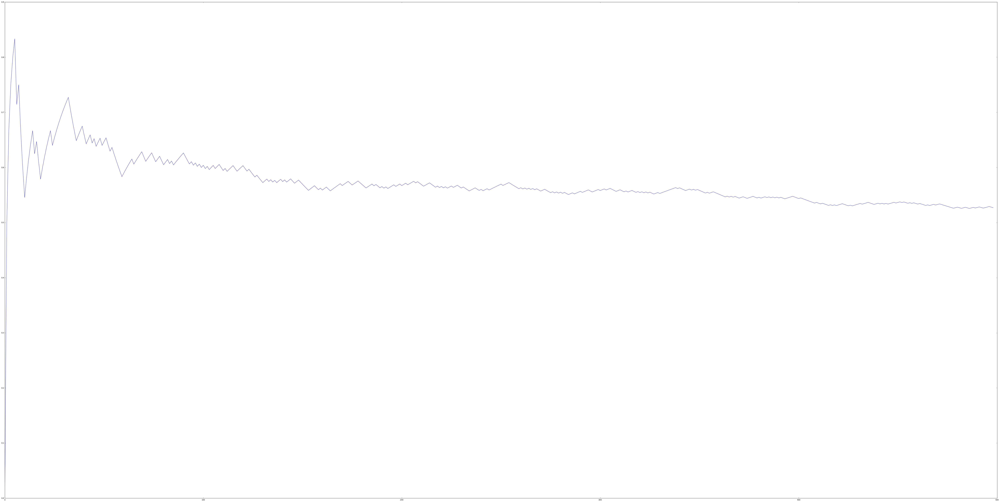

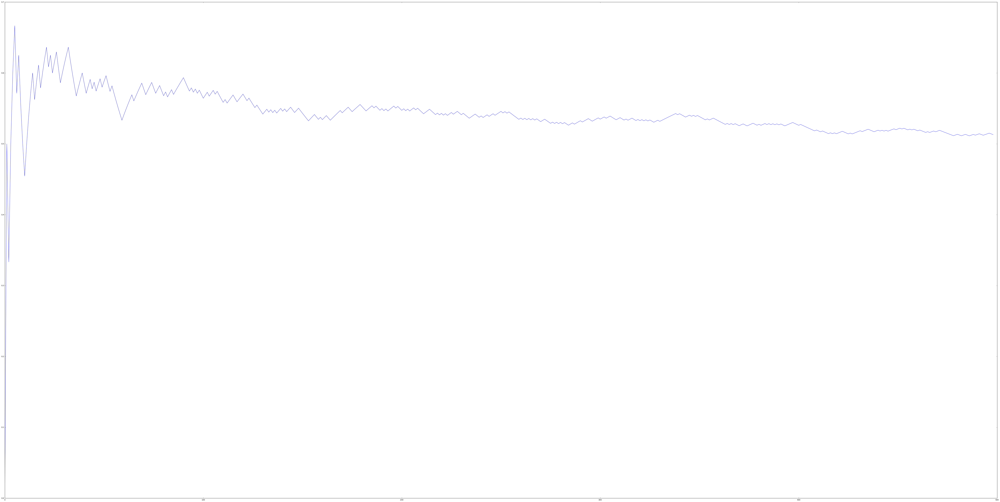

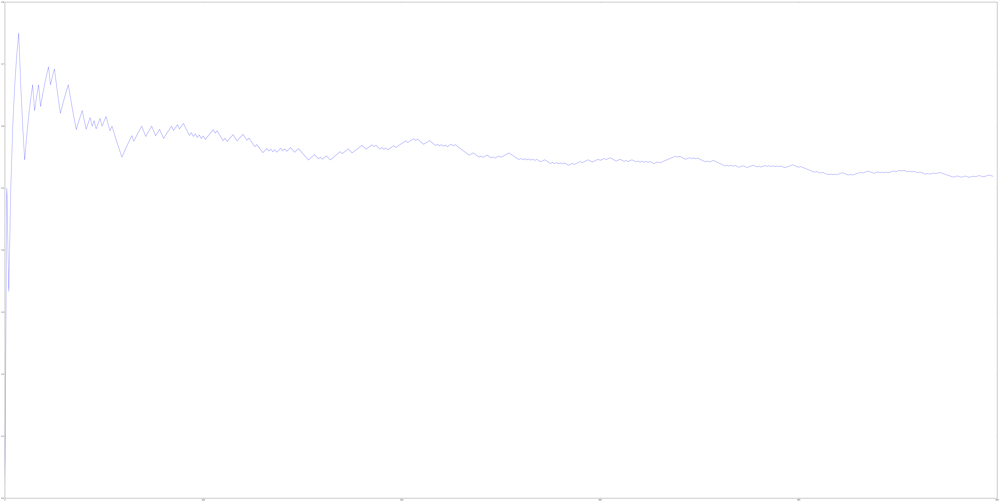

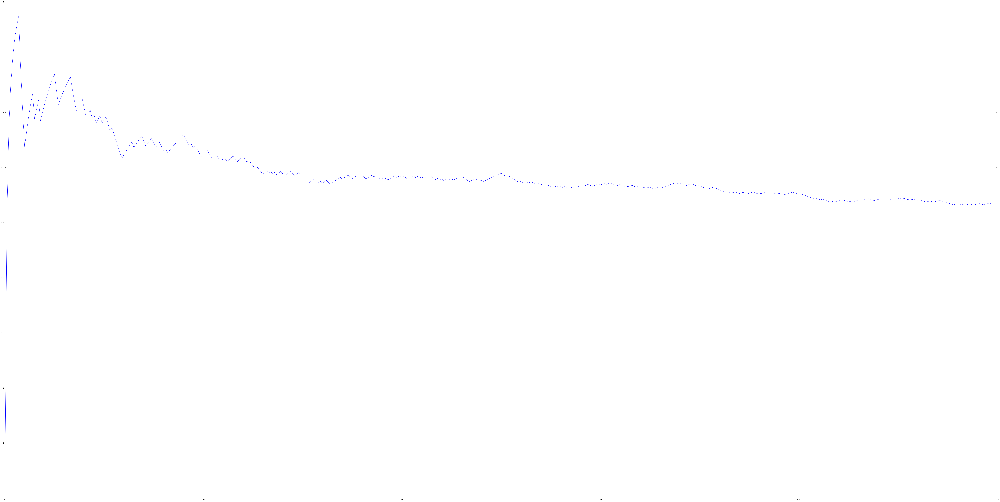

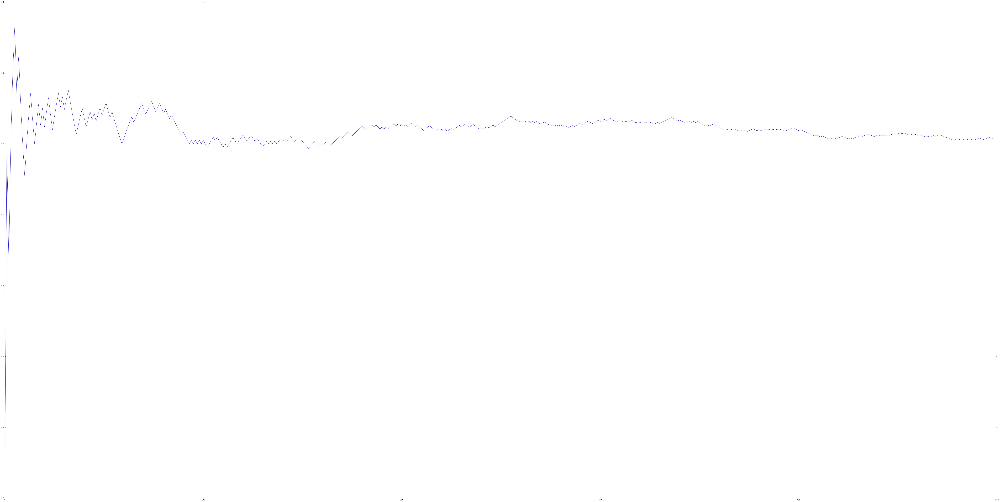

adjclose plot


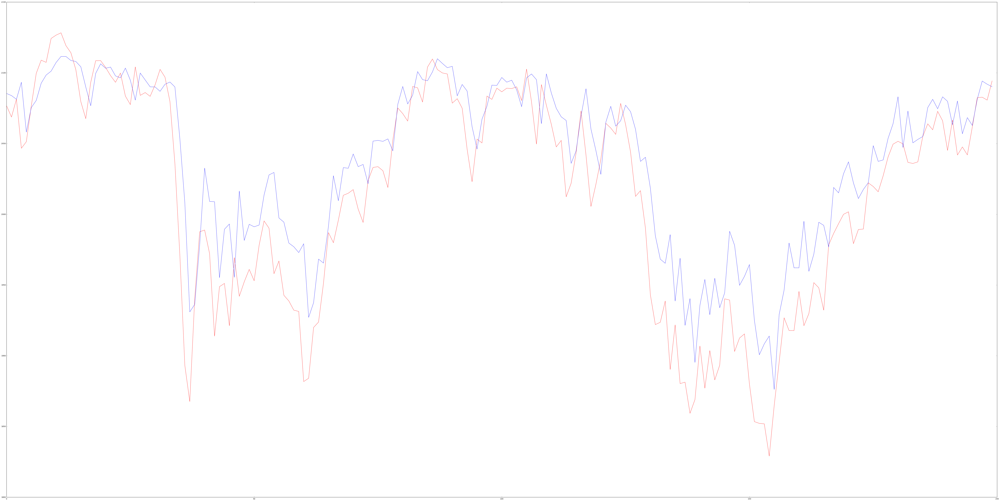

mean of train_RMSE
108.514314532
std of train_RMSE
18.3846245689
mean of test_RMSE
93.9044030688
std of test_RMSE
29.330869416
mean of test_r2Score
0.562701928186
std of test_r2Score
0.237901276279
mean of accuracy_all
0.555936555407
std of accuracy_all
0.023565982225
mean of accuracy_30
0.646666666667
std of accuracy_30
0.0618241233033
time cost
12832.474975585938


In [9]:
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score



import time
start = time.time()
train_RMSE=[]
test_RMSE=[]
test_r2Score=[]
accuracy_all=[]
accuracy_30=[]

for i in range(repeats):
    trainX,trainY,testX,testY,scaler_dataset,scaler_target=preparedata([Open,High,Low,Close,Adjclose,Vloume])
    # create and fit the LSTM network
    model = Sequential()
    model.add(LSTM(4, batch_input_shape=(1, 1, 6), stateful=True))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    for i in range(500):
        model.fit(trainX, trainY, epochs=1, batch_size=1, verbose=2, shuffle=False)
        model.reset_states()


    # make predictions
    trainPredict = model.predict(trainX, batch_size=1)
    testPredict = model.predict(testX, batch_size=1)
    # invert predictions
    trainPredict =  scaler_target.inverse_transform(trainPredict)
    trainY =  scaler_target.inverse_transform(trainY)
    testPredict =  scaler_target.inverse_transform(testPredict)
    testY =  scaler_target.inverse_transform(testY)
    # calculate root mean squared error
    train_RMSE.append(math.sqrt(mean_squared_error(trainY, trainPredict)))
    
    test_RMSE.append(math.sqrt(mean_squared_error(testY, testPredict)))
    
   
    test_r2Score.append(r2_score(testY, testPredict))

    

    #transfer to classification probelm
    test_true=testY[:]
    test_pred=testPredict[:]

    test_true_clssfi=[]
    for  i in range(1,len(test_true)):
        if test_true[i]>test_true[i-1]:
            test_true_clssfi.append(1)
        else:
            test_true_clssfi.append(0)

    test_pred_clssfi=[]
    for  i in range(1,len(test_pred)):
        if test_pred[i]>test_true[i-1]:
            test_pred_clssfi.append(1)
        else:
            test_pred_clssfi.append(0)

    accuracy=[]
    for i in range(1,len(test_pred_clssfi)+1):
        accuracy.append(accuracy_score(test_true_clssfi[0:i],test_pred_clssfi[0:i]))
    fig, ax = plt.subplots(figsize=(100, 50))
    plt.plot(accuracy)
    accuracy_all.append(np.mean(accuracy))
    print(accuracy[29])
    accuracy_30.append(accuracy[29])

print('accuracy plot')    
plt.show()

print('adjclose plot')  
test_true=testY[:200]
test_pred=testPredict[:200]

fig, ax = plt.subplots(figsize=(100, 50))
plt.plot(test_true,color='red')
plt.plot(test_pred,color='blue')
plt.show()

print('mean of train_RMSE')
print(np.mean(train_RMSE))

print('std of train_RMSE')
print(np.std(train_RMSE))

print('mean of test_RMSE')
print(np.mean(test_RMSE))

print('std of test_RMSE')
print(np.std(test_RMSE))

print('mean of test_r2Score')
print(np.mean(test_r2Score))

print('std of test_r2Score')
print(np.std(test_r2Score))

print('mean of accuracy_all')
print(np.mean(accuracy_all))

print('std of accuracy_all')
print(np.std(accuracy_all))

print('mean of accuracy_30')
print(np.mean(accuracy_30))

print('std of accuracy_30')
print(np.std(accuracy_30))

print('time cost')
print( time.time() - start)  

In [10]:
import winsound
winsound.Beep(300,5000)

3.3 statelful,epochs=100,layer=1,neuron=4,dropout=0,all features

Epoch 1/1
9s - loss: 4.8756e-04
Epoch 1/1
7s - loss: 2.8391e-04
Epoch 1/1
6s - loss: 2.1236e-04
Epoch 1/1
6s - loss: 1.8128e-04
Epoch 1/1
6s - loss: 1.6173e-04
Epoch 1/1
6s - loss: 1.4879e-04
Epoch 1/1
6s - loss: 1.3998e-04
Epoch 1/1
7s - loss: 1.3366e-04
Epoch 1/1
6s - loss: 1.2882e-04
Epoch 1/1
6s - loss: 1.2480e-04
Epoch 1/1
6s - loss: 1.2139e-04
Epoch 1/1
6s - loss: 1.1845e-04
Epoch 1/1
6s - loss: 1.1588e-04
Epoch 1/1
6s - loss: 1.1357e-04
Epoch 1/1
6s - loss: 1.1142e-04
Epoch 1/1
6s - loss: 1.0945e-04
Epoch 1/1
6s - loss: 1.0766e-04
Epoch 1/1
6s - loss: 1.0597e-04
Epoch 1/1
6s - loss: 1.0441e-04
Epoch 1/1
6s - loss: 1.0296e-04
Epoch 1/1
6s - loss: 1.0158e-04
Epoch 1/1
6s - loss: 1.0029e-04
Epoch 1/1
6s - loss: 9.9142e-05
Epoch 1/1
6s - loss: 9.8151e-05
Epoch 1/1
6s - loss: 9.7177e-05
Epoch 1/1
6s - loss: 9.6340e-05
Epoch 1/1
6s - loss: 9.5679e-05
Epoch 1/1
6s - loss: 9.5179e-05
Epoch 1/1
6s - loss: 9.4792e-05
Epoch 1/1
6s - loss: 9.4517e-05
Epoch 1/1
6s - loss: 9.4532e-05
Epoch 1/

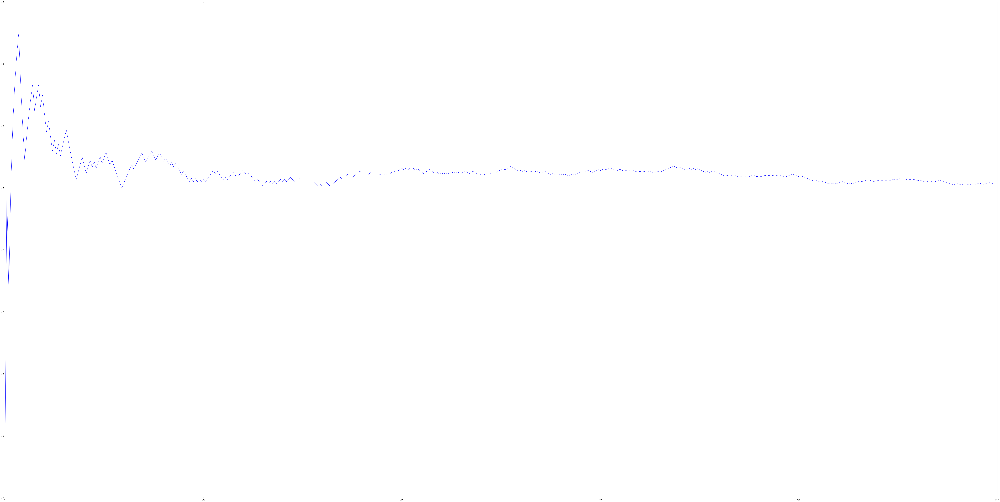

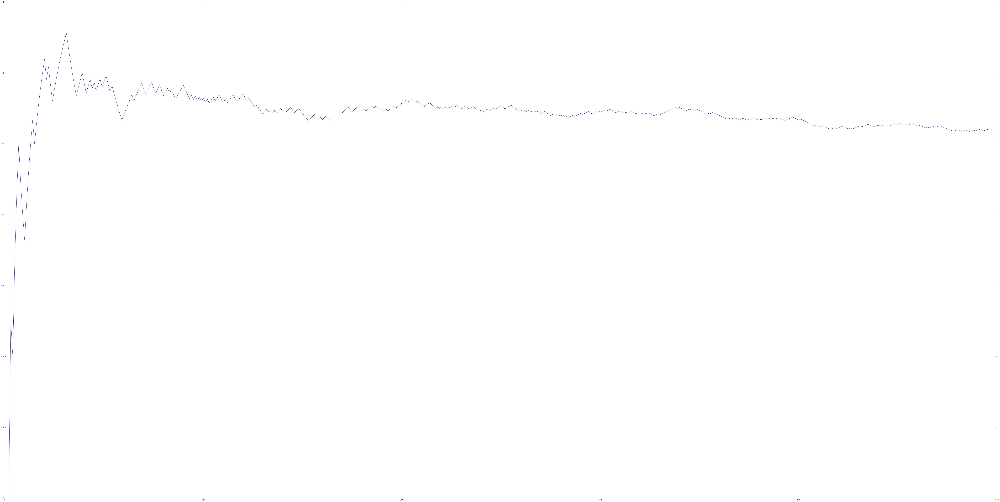

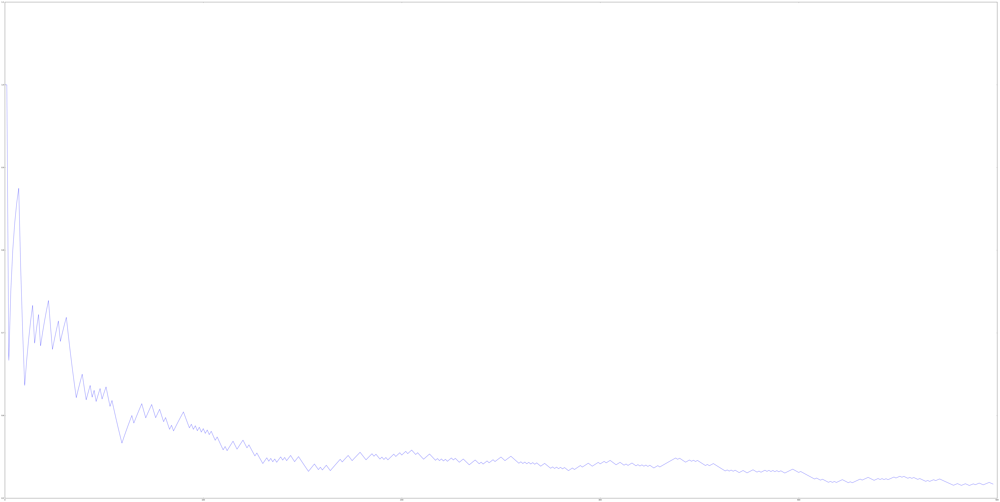

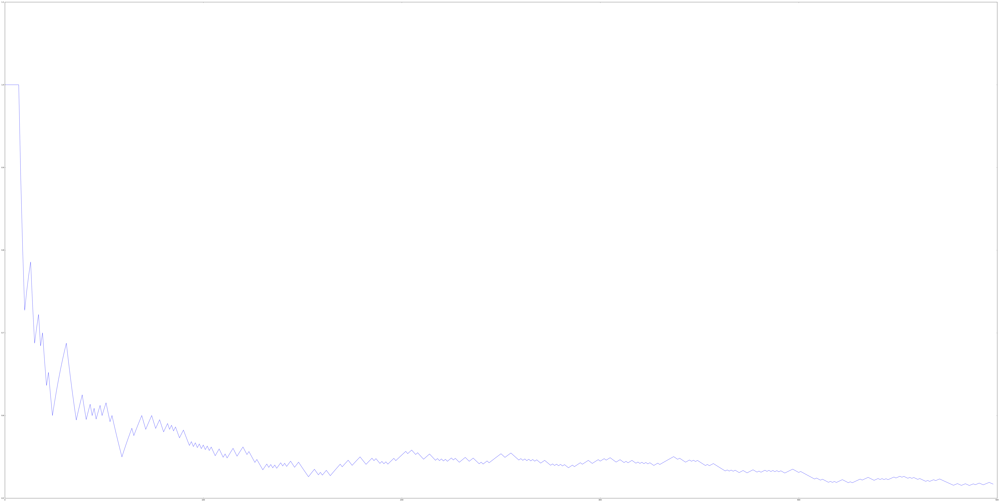

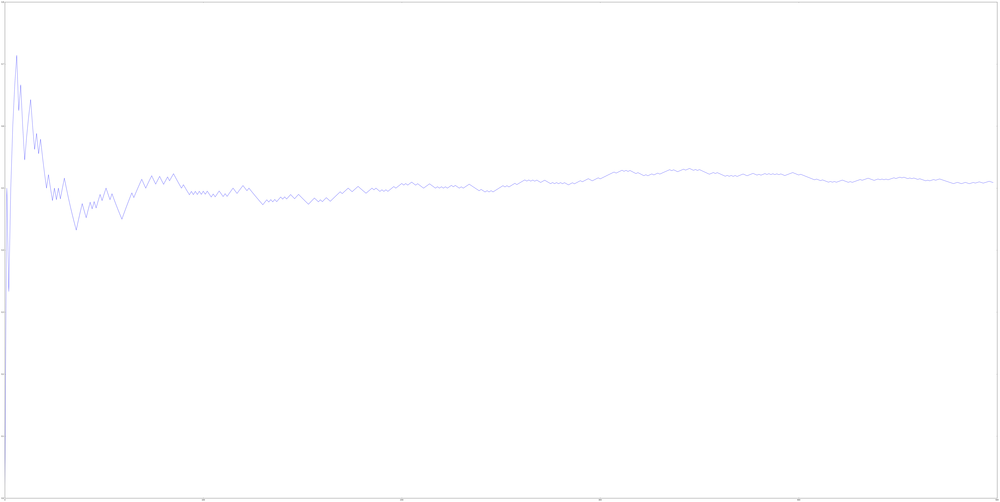

adjclose plot


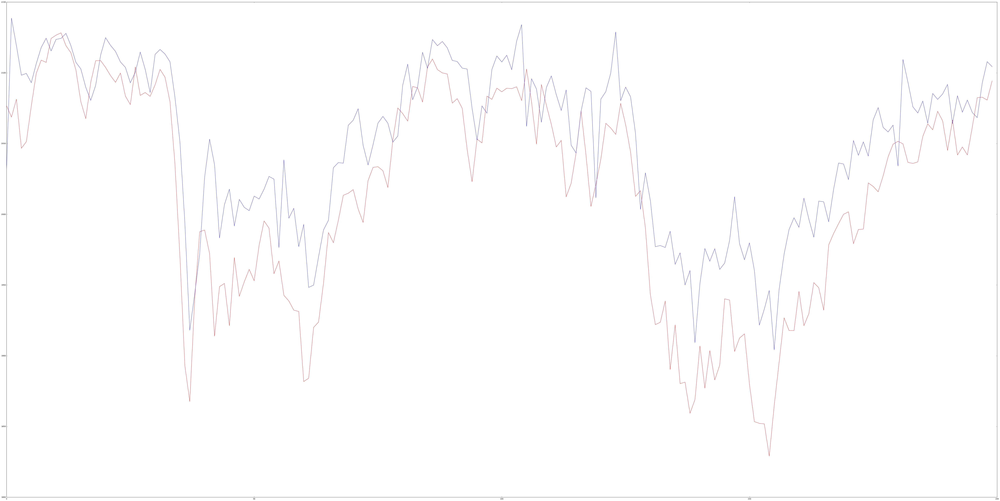

mean of train_RMSE
146.581806398
std of train_RMSE
3.85754762979
mean of test_RMSE
64.7286298492
std of test_RMSE
5.45360271139
mean of test_r2Score
0.809347878773
std of test_r2Score
0.0310010753432
mean of accuracy_all
0.538971802824
std of accuracy_all
0.020741476275
mean of accuracy_30
0.613333333333
std of accuracy_30
0.0718021974285
time cost
3383.420520544052


In [12]:
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score


import time
start = time.time()
train_RMSE=[]
test_RMSE=[]
test_r2Score=[]
accuracy_all=[]
accuracy_30=[]

for i in range(repeats):
    trainX,trainY,testX,testY,scaler_dataset,scaler_target=preparedata([Open,High,Low,Close,Adjclose,Vloume])
    # create and fit the LSTM network
    model = Sequential()
    model.add(LSTM(4, batch_input_shape=(1, 1, 6), stateful=True))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    for i in range(100):
        model.fit(trainX, trainY, epochs=1, batch_size=1, verbose=2, shuffle=False)
        model.reset_states()


    # make predictions
    trainPredict = model.predict(trainX, batch_size=1)
    model.reset_states()
    testPredict = model.predict(testX, batch_size=1)
    # invert predictions
    trainPredict =  scaler_target.inverse_transform(trainPredict)
    trainY =  scaler_target.inverse_transform(trainY)
    testPredict =  scaler_target.inverse_transform(testPredict)
    testY =  scaler_target.inverse_transform(testY)
    # calculate root mean squared error and R2 score
    train_RMSE.append(math.sqrt(mean_squared_error(trainY, trainPredict)))
    
    test_RMSE.append(math.sqrt(mean_squared_error(testY, testPredict)))
    
   
    test_r2Score.append(r2_score(testY, testPredict))

    

    #transfer to classification probelm
    test_true=testY[:]
    test_pred=testPredict[:]

    test_true_clssfi=[]
    for  i in range(1,len(test_true)):
        if test_true[i]>test_true[i-1]:
            test_true_clssfi.append(1)
        else:
            test_true_clssfi.append(0)

    test_pred_clssfi=[]
    for  i in range(1,len(test_pred)):
        if test_pred[i]>test_true[i-1]:
            test_pred_clssfi.append(1)
        else:
            test_pred_clssfi.append(0)

    accuracy=[]
    for i in range(1,len(test_pred_clssfi)+1):
        accuracy.append(accuracy_score(test_true_clssfi[0:i],test_pred_clssfi[0:i]))
    fig, ax = plt.subplots(figsize=(100, 50))
    plt.plot(accuracy)
    accuracy_all.append(np.mean(accuracy))
    print(accuracy[29])
    accuracy_30.append(accuracy[29])

print('accuracy plot')    
plt.show()

print('adjclose plot')  
test_true=testY[:200]
test_pred=testPredict[:200]

fig, ax = plt.subplots(figsize=(100, 50))
plt.plot(test_true,color='red')
plt.plot(test_pred,color='blue')
plt.show()

print('mean of train_RMSE')
print(np.mean(train_RMSE))

print('std of train_RMSE')
print(np.std(train_RMSE))

print('mean of test_RMSE')
print(np.mean(test_RMSE))

print('std of test_RMSE')
print(np.std(test_RMSE))

print('mean of test_r2Score')
print(np.mean(test_r2Score))

print('std of test_r2Score')
print(np.std(test_r2Score))

print('mean of accuracy_all')
print(np.mean(accuracy_all))

print('std of accuracy_all')
print(np.std(accuracy_all))

print('mean of accuracy_30')
print(np.mean(accuracy_30))

print('std of accuracy_30')
print(np.std(accuracy_30))

print('time cost')
print( time.time() - start)  

In [13]:
import winsound
winsound.Beep(300,5000)

4,tuning,base on the best model,statefull(each step use the best tuned hyperparameter from last step)

4.1,tune epochs:100-5000

In [16]:
repeats=5

Epoch 1/1
8s - loss: 3.2609e-04
Epoch 1/1
5s - loss: 2.8289e-04
Epoch 1/1
5s - loss: 2.3028e-04
Epoch 1/1
5s - loss: 2.0147e-04
Epoch 1/1
5s - loss: 1.8111e-04
Epoch 1/1
5s - loss: 1.6619e-04
Epoch 1/1
5s - loss: 1.5538e-04
Epoch 1/1
5s - loss: 1.4638e-04
Epoch 1/1
5s - loss: 1.3886e-04
Epoch 1/1
5s - loss: 1.3271e-04
Epoch 1/1
5s - loss: 1.2777e-04
Epoch 1/1
5s - loss: 1.2384e-04
Epoch 1/1
5s - loss: 1.2058e-04
Epoch 1/1
5s - loss: 1.1778e-04
Epoch 1/1
5s - loss: 1.1548e-04
Epoch 1/1
5s - loss: 1.1355e-04
Epoch 1/1
5s - loss: 1.1192e-04
Epoch 1/1
5s - loss: 1.1050e-04
Epoch 1/1
5s - loss: 1.0920e-04
Epoch 1/1
5s - loss: 1.0808e-04
Epoch 1/1
5s - loss: 1.0709e-04
Epoch 1/1
5s - loss: 1.0618e-04
Epoch 1/1
5s - loss: 1.0530e-04
Epoch 1/1
5s - loss: 1.0438e-04
Epoch 1/1
5s - loss: 1.0356e-04
Epoch 1/1
5s - loss: 1.0268e-04
Epoch 1/1
5s - loss: 1.0180e-04
Epoch 1/1
5s - loss: 1.0090e-04
Epoch 1/1
5s - loss: 1.0003e-04
Epoch 1/1
5s - loss: 9.9110e-05
Epoch 1/1
5s - loss: 9.8124e-05
Epoch 1/

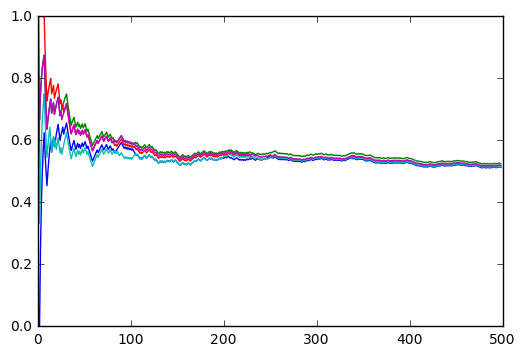

adjclose plot


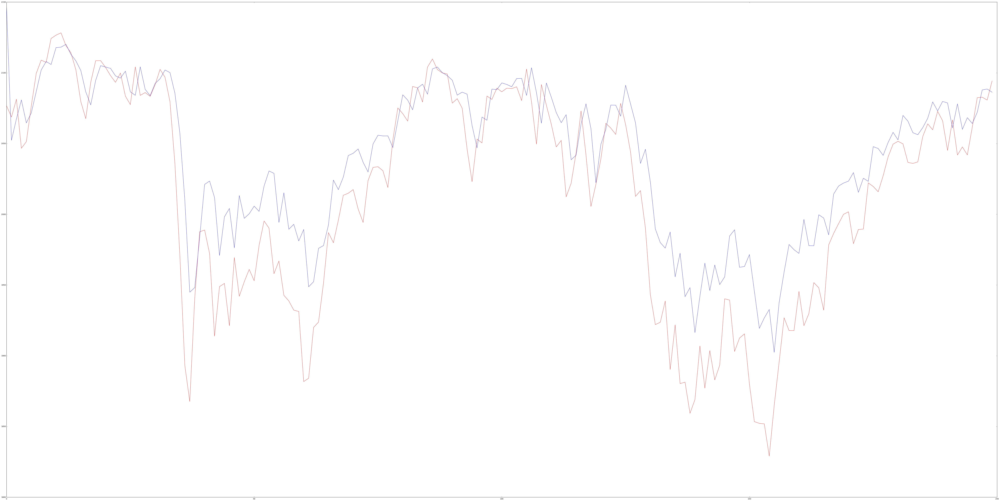

mean of test_RMSE
75.1221654434
std of test_RMSE
8.84449286404
mean of test_r2Score
0.741481504381
std of test_r2Score
0.0575413972699
mean of accuracy_all
0.556111805744
std of accuracy_all
0.0147088275907
mean of accuracy_30
0.683870967742
std of accuracy_30
0.0474094788926
time cost
2759.0848104953766
Epoch 1/1
7s - loss: 4.0999e-04
Epoch 1/1
5s - loss: 3.0113e-04
Epoch 1/1
5s - loss: 2.5460e-04
Epoch 1/1
5s - loss: 2.1938e-04
Epoch 1/1
5s - loss: 1.8847e-04
Epoch 1/1
5s - loss: 1.7282e-04
Epoch 1/1
5s - loss: 1.5370e-04
Epoch 1/1
5s - loss: 1.3990e-04
Epoch 1/1
5s - loss: 1.3234e-04
Epoch 1/1
5s - loss: 1.2636e-04
Epoch 1/1
5s - loss: 1.2174e-04
Epoch 1/1
5s - loss: 1.1810e-04
Epoch 1/1
5s - loss: 1.1525e-04
Epoch 1/1
5s - loss: 1.1275e-04
Epoch 1/1
5s - loss: 1.1058e-04
Epoch 1/1
5s - loss: 1.0884e-04
Epoch 1/1
5s - loss: 1.0704e-04
Epoch 1/1
5s - loss: 1.0573e-04
Epoch 1/1
5s - loss: 1.0428e-04
Epoch 1/1
5s - loss: 1.0320e-04
Epoch 1/1
5s - loss: 1.0210e-04
Epoch 1/1
5s - loss: 1

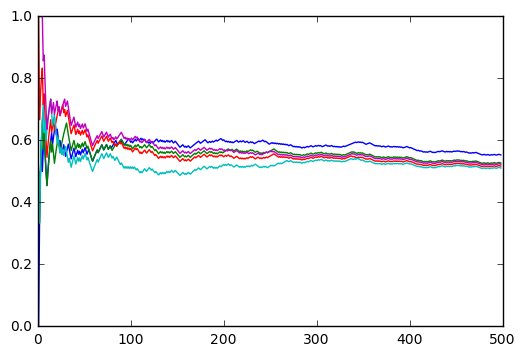

adjclose plot


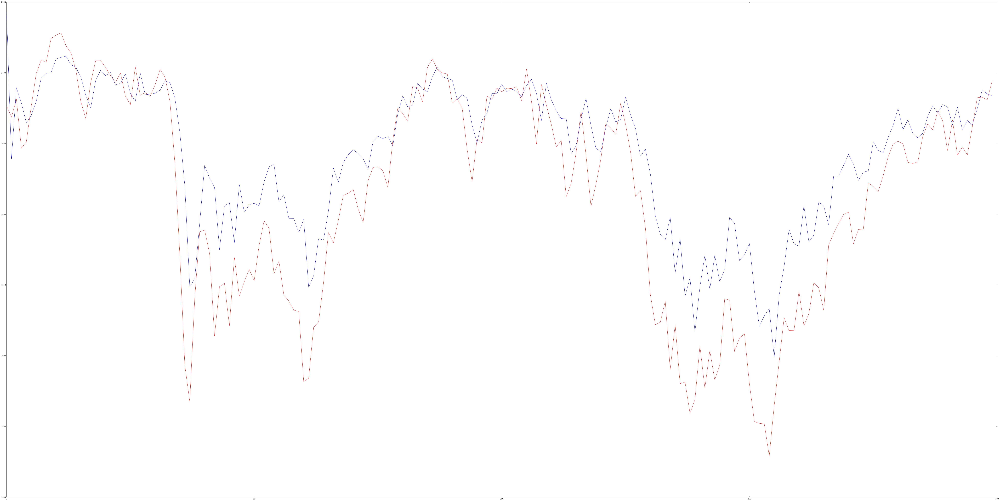

mean of test_RMSE
85.8558210312
std of test_RMSE
33.4118261459
mean of test_r2Score
0.6165044788
std of test_r2Score
0.221793210556
mean of accuracy_all
0.558977004621
std of accuracy_all
0.0191458447626
mean of accuracy_30
0.632258064516
std of accuracy_30
0.0598297967451
time cost
8409.105973482132
Epoch 1/1
7s - loss: 5.2192e-04
Epoch 1/1
5s - loss: 2.6941e-04
Epoch 1/1
5s - loss: 2.2214e-04
Epoch 1/1
5s - loss: 1.9140e-04
Epoch 1/1
5s - loss: 1.6832e-04
Epoch 1/1
5s - loss: 1.5246e-04
Epoch 1/1
5s - loss: 1.4133e-04
Epoch 1/1
5s - loss: 1.3399e-04
Epoch 1/1
5s - loss: 1.2873e-04
Epoch 1/1
5s - loss: 1.2470e-04
Epoch 1/1
5s - loss: 1.2136e-04
Epoch 1/1
5s - loss: 1.1865e-04
Epoch 1/1
5s - loss: 1.1627e-04
Epoch 1/1
5s - loss: 1.1413e-04
Epoch 1/1
5s - loss: 1.1218e-04
Epoch 1/1
5s - loss: 1.1021e-04
Epoch 1/1
5s - loss: 1.0857e-04
Epoch 1/1
5s - loss: 1.0714e-04
Epoch 1/1
5s - loss: 1.0592e-04
Epoch 1/1
5s - loss: 1.0480e-04
Epoch 1/1
5s - loss: 1.0370e-04
Epoch 1/1
5s - loss: 1.027

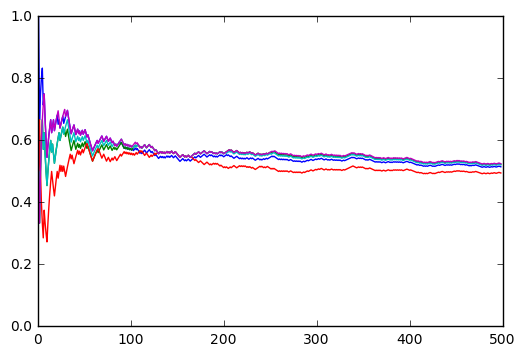

adjclose plot


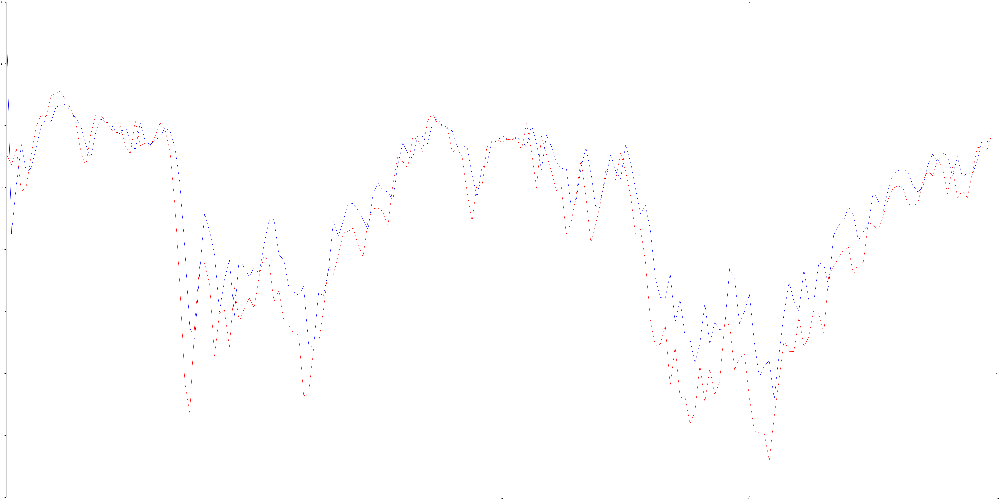

mean of test_RMSE
98.1747492995
std of test_RMSE
32.6906412267
mean of test_r2Score
0.516225498513
std of test_r2Score
0.294236645492
mean of accuracy_all
0.548750269513
std of accuracy_all
0.0166698011458
mean of accuracy_30
0.61935483871
std of accuracy_30
0.0718421208107
time cost
14390.584094285965
Epoch 1/1
7s - loss: 3.2540e-04
Epoch 1/1
5s - loss: 3.0718e-04
Epoch 1/1
5s - loss: 2.6749e-04
Epoch 1/1
5s - loss: 2.2464e-04
Epoch 1/1
5s - loss: 1.8882e-04
Epoch 1/1
5s - loss: 1.6739e-04
Epoch 1/1
5s - loss: 1.5214e-04
Epoch 1/1
5s - loss: 1.4105e-04
Epoch 1/1
5s - loss: 1.3251e-04
Epoch 1/1
5s - loss: 1.2560e-04
Epoch 1/1
5s - loss: 1.1981e-04
Epoch 1/1
5s - loss: 1.1506e-04
Epoch 1/1
5s - loss: 1.1135e-04
Epoch 1/1
5s - loss: 1.0864e-04
Epoch 1/1
5s - loss: 1.0669e-04
Epoch 1/1
5s - loss: 1.0522e-04
Epoch 1/1
5s - loss: 1.0408e-04
Epoch 1/1
5s - loss: 1.0318e-04
Epoch 1/1
5s - loss: 1.0231e-04
Epoch 1/1
5s - loss: 1.0157e-04
Epoch 1/1
5s - loss: 1.0094e-04
Epoch 1/1
5s - loss: 1.0

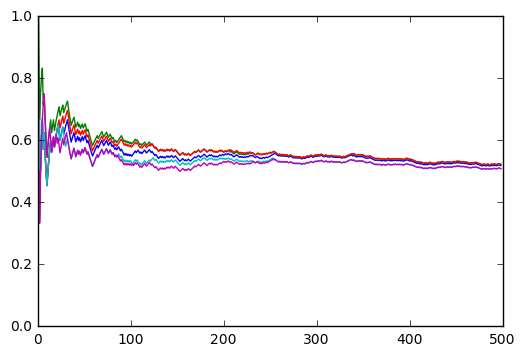

adjclose plot


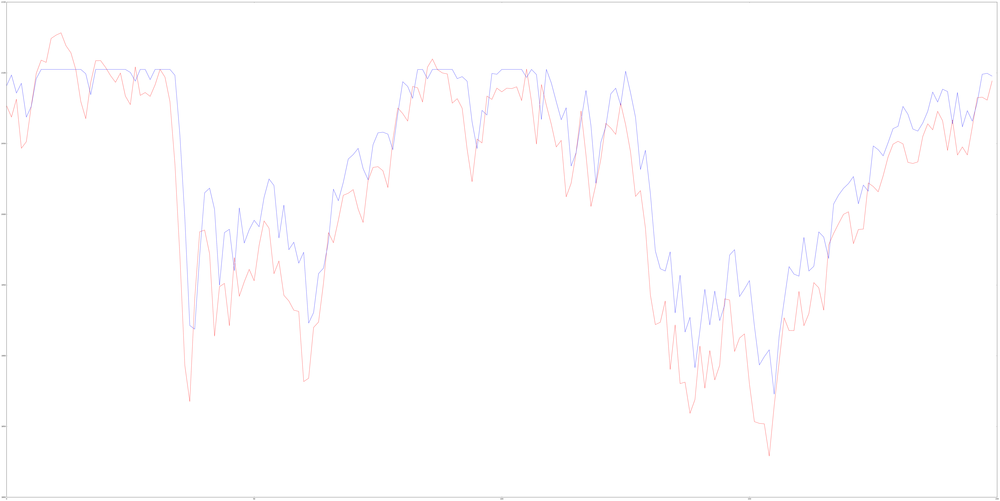

mean of test_RMSE
122.036637921
std of test_RMSE
16.7536441098
mean of test_r2Score
0.314407304518
std of test_r2Score
0.175935991778
mean of accuracy_all
0.548644937651
std of accuracy_all
0.0151527238106
mean of accuracy_30
0.645161290323
std of accuracy_30
0.0456197923346
time cost
20219.16347002983
Epoch 1/1
8s - loss: 4.4394e-04
Epoch 1/1
5s - loss: 6.0599e-04
Epoch 1/1
5s - loss: 3.6552e-04
Epoch 1/1
5s - loss: 2.5916e-04
Epoch 1/1
5s - loss: 1.9961e-04
Epoch 1/1
5s - loss: 1.6492e-04
Epoch 1/1
5s - loss: 1.4540e-04
Epoch 1/1
5s - loss: 1.3362e-04
Epoch 1/1
5s - loss: 1.2576e-04
Epoch 1/1
5s - loss: 1.2015e-04
Epoch 1/1
5s - loss: 1.1619e-04
Epoch 1/1
5s - loss: 1.1300e-04
Epoch 1/1
5s - loss: 1.1070e-04
Epoch 1/1
5s - loss: 1.0881e-04
Epoch 1/1
5s - loss: 1.0726e-04
Epoch 1/1
5s - loss: 1.0620e-04
Epoch 1/1
5s - loss: 1.0510e-04
Epoch 1/1
5s - loss: 1.0441e-04
Epoch 1/1
5s - loss: 1.0354e-04
Epoch 1/1
5s - loss: 1.0285e-04
Epoch 1/1
5s - loss: 1.0228e-04
Epoch 1/1
5s - loss: 1.0

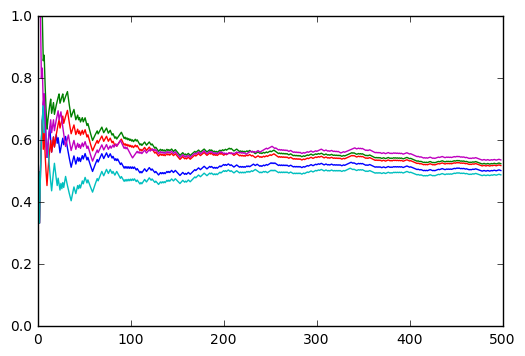

adjclose plot


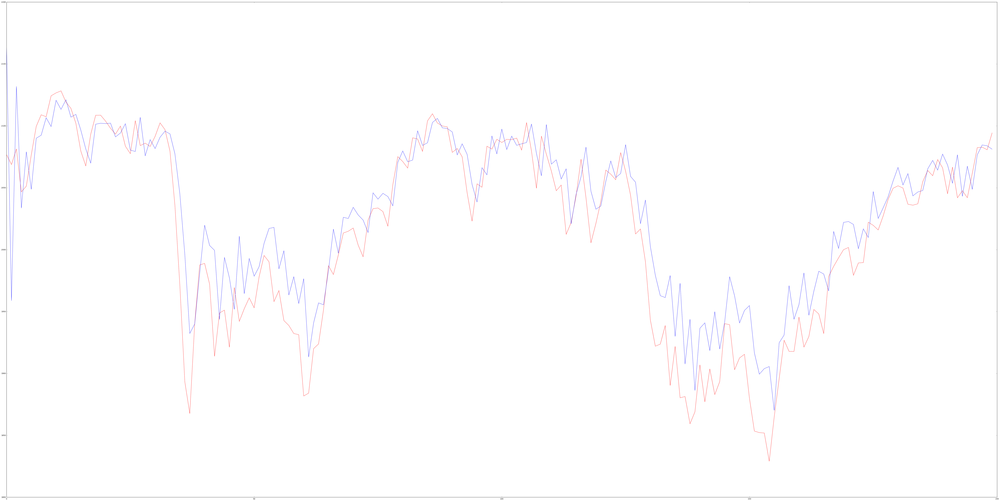

mean of test_RMSE
109.111526437
std of test_RMSE
34.6517967107
mean of test_r2Score
0.407825930959
std of test_r2Score
0.271291919872
mean of accuracy_all
0.5422278836
std of accuracy_all
0.033843654376
mean of accuracy_30
0.61935483871
std of accuracy_30
0.0875139352661
time cost
33554.900230407715
Epoch 1/1
9s - loss: 3.7614e-04
Epoch 1/1
6s - loss: 3.2172e-04
Epoch 1/1
6s - loss: 2.6115e-04
Epoch 1/1
6s - loss: 2.1457e-04
Epoch 1/1
6s - loss: 1.8364e-04
Epoch 1/1
6s - loss: 1.6306e-04
Epoch 1/1
6s - loss: 1.4842e-04
Epoch 1/1
6s - loss: 1.3774e-04
Epoch 1/1
6s - loss: 1.2921e-04
Epoch 1/1
6s - loss: 1.2303e-04
Epoch 1/1
6s - loss: 1.1821e-04
Epoch 1/1
6s - loss: 1.1441e-04
Epoch 1/1
6s - loss: 1.1164e-04
Epoch 1/1
6s - loss: 1.0958e-04
Epoch 1/1
6s - loss: 1.0794e-04
Epoch 1/1
6s - loss: 1.0675e-04
Epoch 1/1
6s - loss: 1.0596e-04
Epoch 1/1
6s - loss: 1.0539e-04
Epoch 1/1
6s - loss: 1.0498e-04
Epoch 1/1
6s - loss: 1.0459e-04
Epoch 1/1
6s - loss: 1.0416e-04
Epoch 1/1
6s - loss: 1.0359

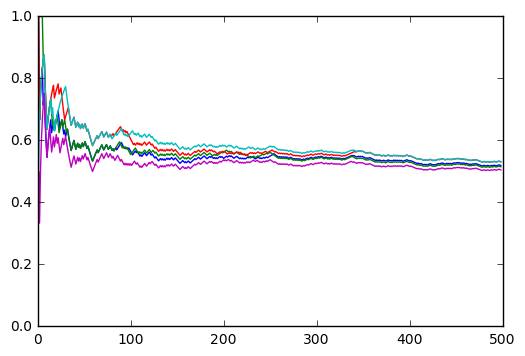

adjclose plot


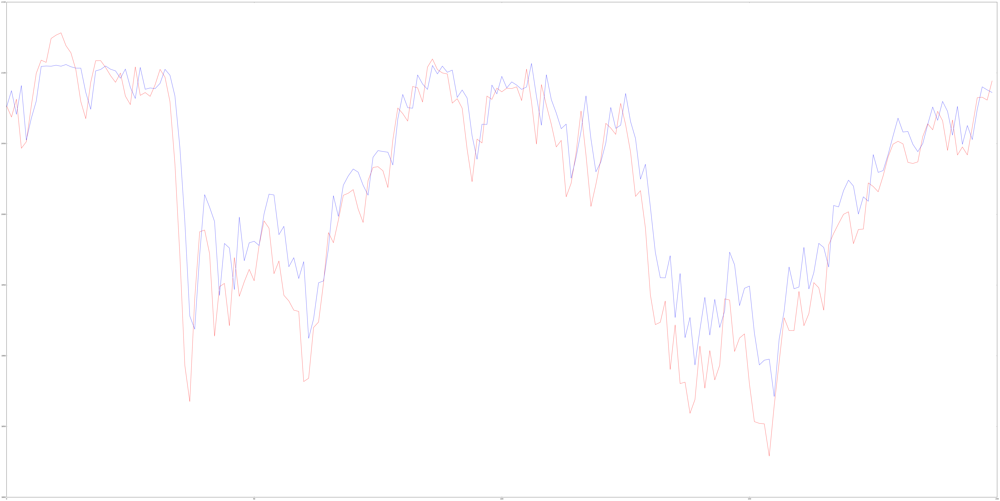

mean of test_RMSE
114.710395195
std of test_RMSE
23.1767925035
mean of test_r2Score
0.381187492042
std of test_r2Score
0.227219922526
mean of accuracy_all
0.559595496695
std of accuracy_all
0.0202198058756
mean of accuracy_30
0.664516129032
std of accuracy_30
0.0598297967451
time cost
53099.88813996315
Epoch 1/1
9s - loss: 4.7609e-04
Epoch 1/1
7s - loss: 5.3996e-04
Epoch 1/1
7s - loss: 3.7538e-04
Epoch 1/1
6s - loss: 2.7726e-04
Epoch 1/1
6s - loss: 2.1347e-04
Epoch 1/1
7s - loss: 1.7659e-04
Epoch 1/1
7s - loss: 1.5445e-04
Epoch 1/1
7s - loss: 1.4015e-04
Epoch 1/1
7s - loss: 1.3029e-04
Epoch 1/1
7s - loss: 1.2319e-04
Epoch 1/1
7s - loss: 1.1790e-04
Epoch 1/1
6s - loss: 1.1381e-04
Epoch 1/1
6s - loss: 1.1065e-04
Epoch 1/1
6s - loss: 1.0828e-04
Epoch 1/1
7s - loss: 1.0646e-04
Epoch 1/1
7s - loss: 1.0501e-04
Epoch 1/1
7s - loss: 1.0379e-04
Epoch 1/1
7s - loss: 1.0274e-04
Epoch 1/1
7s - loss: 1.0184e-04
Epoch 1/1
7s - loss: 1.0105e-04
Epoch 1/1
6s - loss: 1.0033e-04
Epoch 1/1
6s - loss: 9.9

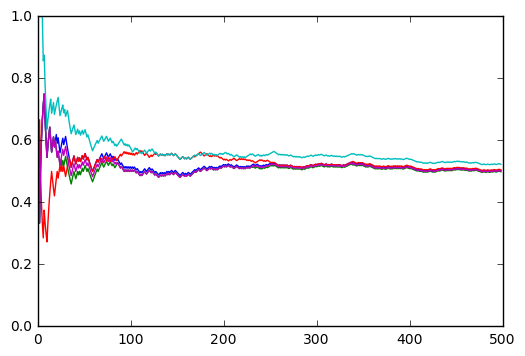

adjclose plot


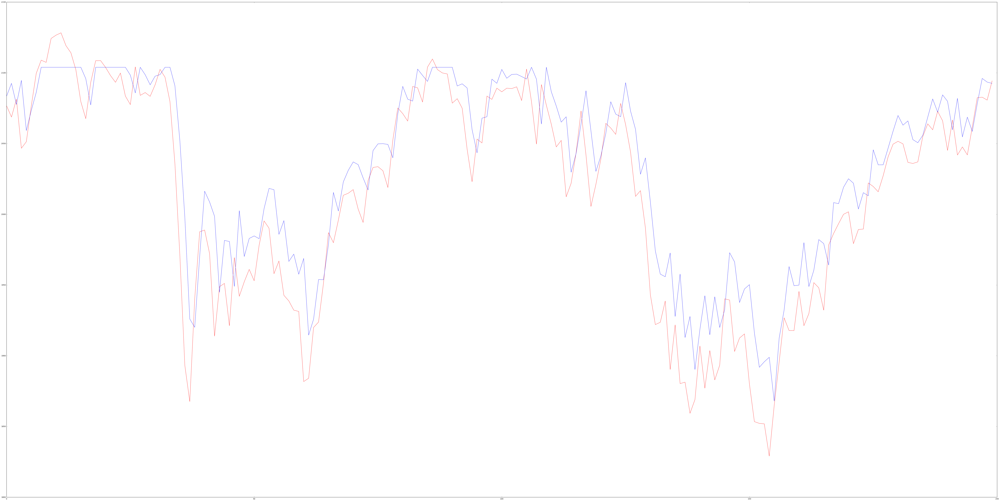

mean of test_RMSE
145.991963529
std of test_RMSE
32.7581857475
mean of test_r2Score
-0.0115046812258
std of test_r2Score
0.490743608349
mean of accuracy_all
0.526896172956
std of accuracy_all
0.0215339418482
mean of accuracy_30
0.58064516129
std of accuracy_30
0.0645161290323
time cost
70959.07662701607
Epoch 1/1
8s - loss: 2.8963e-04
Epoch 1/1
6s - loss: 2.8706e-04
Epoch 1/1
6s - loss: 2.4541e-04
Epoch 1/1
6s - loss: 2.0881e-04
Epoch 1/1
6s - loss: 1.7913e-04
Epoch 1/1
6s - loss: 1.5952e-04
Epoch 1/1
6s - loss: 1.4797e-04
Epoch 1/1
6s - loss: 1.3933e-04
Epoch 1/1
6s - loss: 1.3255e-04
Epoch 1/1
6s - loss: 1.2691e-04
Epoch 1/1
6s - loss: 1.2271e-04
Epoch 1/1
6s - loss: 1.1929e-04
Epoch 1/1
6s - loss: 1.1648e-04
Epoch 1/1
6s - loss: 1.1413e-04
Epoch 1/1
6s - loss: 1.1212e-04
Epoch 1/1
6s - loss: 1.1041e-04
Epoch 1/1
6s - loss: 1.0893e-04
Epoch 1/1
6s - loss: 1.0762e-04
Epoch 1/1
6s - loss: 1.0647e-04
Epoch 1/1
6s - loss: 1.0550e-04
Epoch 1/1
6s - loss: 1.0458e-04
Epoch 1/1
6s - loss: 1.

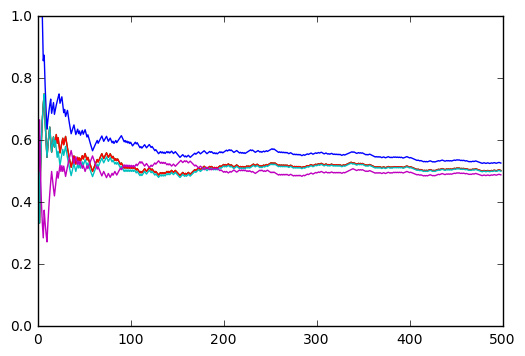

adjclose plot


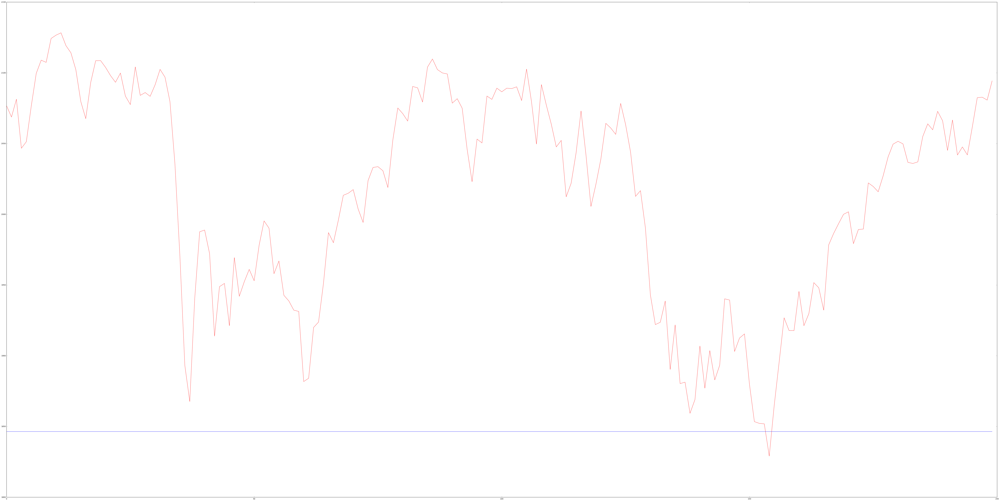

mean of test_RMSE
174.419900094
std of test_RMSE
79.5912728687
mean of test_r2Score
-0.66080153548
std of test_r2Score
1.68233888966
mean of accuracy_all
0.525370270325
std of accuracy_all
0.0257677597725
mean of accuracy_30
0.593548387097
std of accuracy_30
0.0632126385234
time cost
124188.80419325829
Epoch 1/1
18s - loss: 3.5617e-04
Epoch 1/1
11s - loss: 3.5149e-04
Epoch 1/1
11s - loss: 3.0022e-04
Epoch 1/1
11s - loss: 2.3665e-04
Epoch 1/1
11s - loss: 1.9133e-04
Epoch 1/1
11s - loss: 1.6070e-04
Epoch 1/1
11s - loss: 1.4090e-04
Epoch 1/1
12s - loss: 1.2838e-04
Epoch 1/1
14s - loss: 1.2059e-04
Epoch 1/1
15s - loss: 1.1583e-04
Epoch 1/1
15s - loss: 1.1272e-04
Epoch 1/1
14s - loss: 1.1070e-04
Epoch 1/1
15s - loss: 1.0934e-04
Epoch 1/1
14s - loss: 1.0839e-04
Epoch 1/1
14s - loss: 1.0769e-04
Epoch 1/1
14s - loss: 1.0711e-04
Epoch 1/1
14s - loss: 1.0656e-04
Epoch 1/1
15s - loss: 1.0600e-04
Epoch 1/1
15s - loss: 1.0545e-04
Epoch 1/1
15s - loss: 1.0474e-04
Epoch 1/1
15s - loss: 1.0395e-04
Epo

In [ ]:
epochs=[100,300,500,700,1000,1500,2000,3000,4000,5000]

test_RMSE_all=[]
accuracy_all_all=[]

for epoch in epochs:
    
    import time
    start = time.time()
    
    train_RMSE=[]
    test_RMSE=[]
    test_r2Score=[]
    accuracy_all=[]
    accuracy_30=[]

    for i in range(repeats):
        trainX,trainY,testX,testY,scaler_dataset,scaler_target=preparedata([Open,High,Low,Close,Adjclose,Vloume])
        # create and fit the LSTM network
        model = Sequential()
        model.add(LSTM(4, batch_input_shape=(1, 1, 6), stateful=True))
        model.add(Dense(1))
        model.compile(loss='mean_squared_error', optimizer='adam')
        for j in range(epoch):
            model.fit(trainX, trainY, epochs=1, batch_size=1, verbose=2, shuffle=False)
            model.reset_states()


        # make predictions
        testPredict = model.predict(testX, batch_size=1)
        # invert predictions
        testPredict =  scaler_target.inverse_transform(testPredict)
        testY =  scaler_target.inverse_transform(testY)
        # calculate root mean squared error

        test_RMSE.append(math.sqrt(mean_squared_error(testY, testPredict)))


        test_r2Score.append(r2_score(testY, testPredict))



        #transfer to classification probelm
        test_true=testY[:]
        test_pred=testPredict[:]

        test_true_clssfi=[]
        for  i in range(1,len(test_true)):
            if test_true[i]>test_true[i-1]:
                test_true_clssfi.append(1)
            else:
                test_true_clssfi.append(0)

        test_pred_clssfi=[]
        for  i in range(1,len(test_pred)):
            if test_pred[i]>test_true[i-1]:
                test_pred_clssfi.append(1)
            else:
                test_pred_clssfi.append(0)

        accuracy=[]
        for i in range(1,len(test_pred_clssfi)+1):
            accuracy.append(accuracy_score(test_true_clssfi[0:i],test_pred_clssfi[0:i]))
        plt.plot(accuracy)
        accuracy_all.append(np.mean(accuracy))
        accuracy_30.append(np.mean(accuracy[30]))

    print('accuracy plot')    
    plt.show()

    print('adjclose plot')  
    test_true=testY[:200]
    test_pred=testPredict[:200]

    fig, ax = plt.subplots(figsize=(100, 50))
    plt.plot(test_true,color='red')
    plt.plot(test_pred,color='blue')
    plt.show()

    print('mean of test_RMSE')
    print(np.mean(test_RMSE))

    print('std of test_RMSE')
    print(np.std(test_RMSE))

    print('mean of test_r2Score')
    print(np.mean(test_r2Score))

    print('std of test_r2Score')
    print(np.std(test_r2Score))

    print('mean of accuracy_all')
    print(np.mean(accuracy_all))

    print('std of accuracy_all')
    print(np.std(accuracy_all))

    print('mean of accuracy_30')
    print(np.mean(accuracy_30))

    print('std of accuracy_30')
    print(np.std(accuracy_30))

    print('time cost')
    print( time.time() - start)   
    
    test_RMSE_all.append(np.mean(test_RMSE))
    accuracy_all_all.append(np.mean(accuracy_all))

plt.plot(epochs,test_RMSE_all)
plt.title('Finding the best hyperparameter')
plt.xlabel('Epochs')
plt.ylabel('test_RMSE')
plt.show()

plt.plot(epochs,accuracy_all_all)
plt.title('Finding the best hyperparameter')
plt.xlabel('Epochs')
plt.ylabel('accuracy_all')
plt.show()